In [2]:
import numpy as np
import xarray as xr
import os.path as op
import xrft
import dask.array as dsar
from dask.diagnostics import ProgressBar
from scipy.io import loadmat
from scipy.interpolate import PchipInterpolator as pchip
from xmitgcm import open_mdsdataset
from xgcm.grid import Grid
from matplotlib.colors import LogNorm, SymLogNorm
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
bdir = '/swot/SUM02/takaya/channelMOC-Darwin/'
pdir = '/swot/SUM05/takaya/MITgcm/channel/runs/'

In [4]:
# 05km_mp113-15_mu15-114_Kp01-018_Ki59-105_Kn015-035_g28-168_mz40_rFe1
ys, dy = (30,10)
dt = 3e2
df = 288
# ts = int(360*86400*ys/dt + 360*86400*15e0/3e2)
ts = int(360*86400*ys/6e2 + 360*86400*15e0/3e2 + 360*86400*57e0/6e2 + 14.5*360*86400/dt)
te = int(ts+360*86400*dy/dt)
print(ts,te)

7568640 8605440


In [ ]:
ds = open_mdsdataset(
#                     op.join(bdir,'05km_mp113-15_mu15-114_Kp01-018_Ki59-105_Kn015-035_g28-168_mz40_rFe1'), 
                    op.join(bdir,'05km_wFe'), 
                    grid_dir=op.join(pdir,'5km_grid'),
#                     iters=range(ts+int(2*360*86400/dt)+12,ts+int(3*360*86400/dt)+12,12),
#                     prefix=['WFe1hr'], 
#                     iters=range(ts+int(2*360*86400/dt),ts+int(3*360*86400/dt),12),
#                     prefix=['WFe1hr_snap'],
                    iters=range(ts+int(2*360*86400/dt)+2,ts+int(3*360*86400/dt)+2,2),
                    prefix=['WFe10mn'],
                    delta_t=dt
                    )
ds

/home/takaya/xmitgcm/xmitgcm/utils.py:314: UserWarning: Not sure what to do with rlev = L
  warnings.warn("Not sure what to do with rlev = " + rlev)


In [7]:
nt90 = int(90*24*60/10)
nz100 = 22
nz300 = 33
nz400 = 36
ds.Zl[22]

<xarray.DataArray 'Zl' ()>
array(-105.22, dtype=float32)
Coordinates:
    Zl       >f4 -105.22
Attributes:
    standard_name:      depth_at_upper_w_location
    long_name:          vertical coordinate of upper cell interface
    units:              m
    positive:           down
    axis:               Z
    c_grid_axis_shift:  -0.5

In [8]:
grid = Grid(ds.sel(YC=slice(6e5,14e5), YG=slice(6e5,14e5)), periodic=['X'])
w = ds.WVEL.sel(YC=slice(6e5,14e5))
Fe = grid.interp(ds.TRAC03.sel(YC=slice(6e5,14e5)),'Z',boundary='fill')
wp = w[-int(2*nt90):-nt90,nz300] - w[-int(2*nt90):-nt90,nz300].mean(['time','XC'])
Fep = Fe[-int(2*nt90):-nt90,nz300] - Fe[-int(2*nt90):-nt90,nz300].mean(['time','XC'])
wkf = xrft.dft(wp, dim=['XC'], detrend='constant')
Fekf = xrft.dft(Fep, dim=['XC'], detrend='constant')
freq_XC_spacing = wkf.freq_XC_spacing
with ProgressBar():
    wkf = xrft.dft(wkf.chunk({'time':len(wkf.time),'YC':100}), dim=['time'], detrend='constant', window=True).compute()
    Fekf = xrft.dft(Fekf.chunk({'time':len(Fekf.time),'YC':100}), dim=['time'], detrend='constant', window=True).compute()

/home/takaya/xrft/xrft/xrft.py:272: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  elif d in da:
/home/takaya/xrft/xrft/xrft.py:272: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  elif d in da:
/home/takaya/xrft/xrft/xrft.py:272: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  elif d in da:


[########################################] | 100% Completed | 59min 41.2s


/home/takaya/xrft/xrft/xrft.py:272: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  elif d in da:


[########################################] | 100% Completed | 55min 57.9s


In [27]:
ds.WVEL[:,0].to_netcdf(op.join(pdir,'SurfaceW_hourly.nc'))

In [28]:
ds.WVEL[:,nz300].to_netcdf(op.join(pdir,'z300W_hourly.nc'))

/home/takaya/miniconda3/envs/uptodate/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/home/takaya/miniconda3/envs/uptodate/lib/python3.6/site-packages/matplotlib/figure.py:2299: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


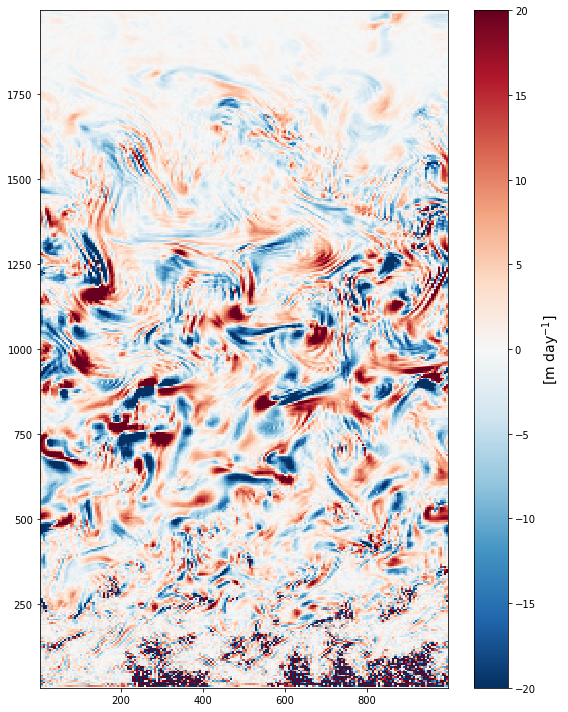

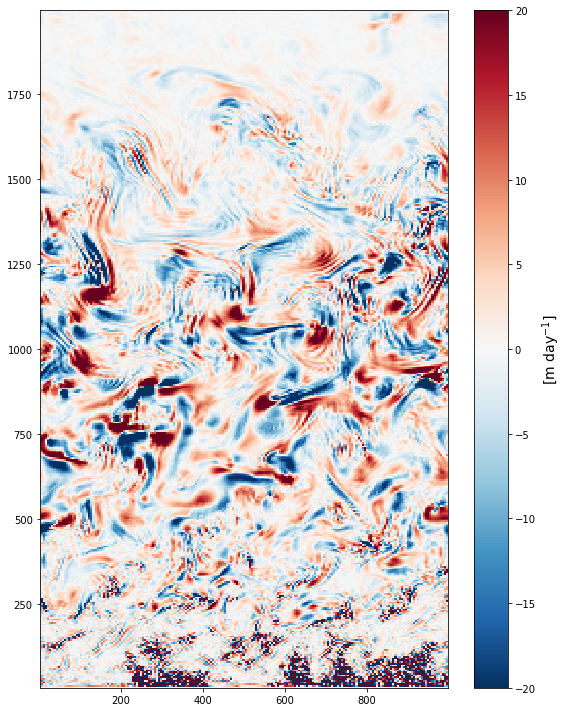

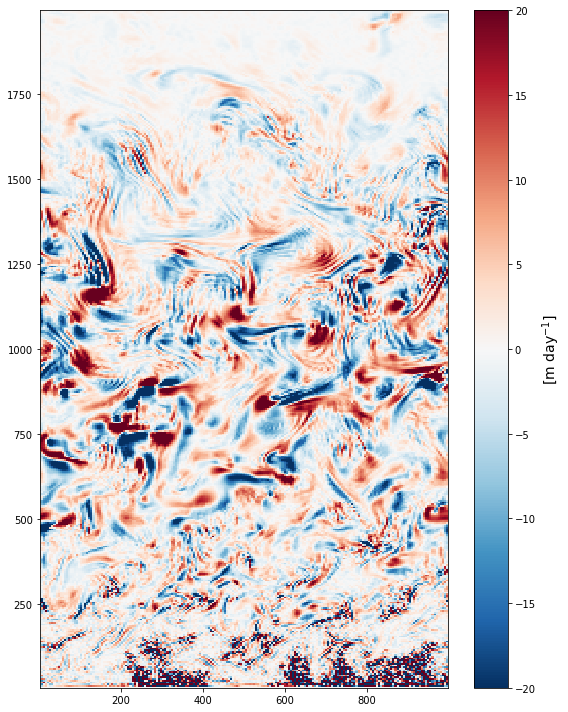

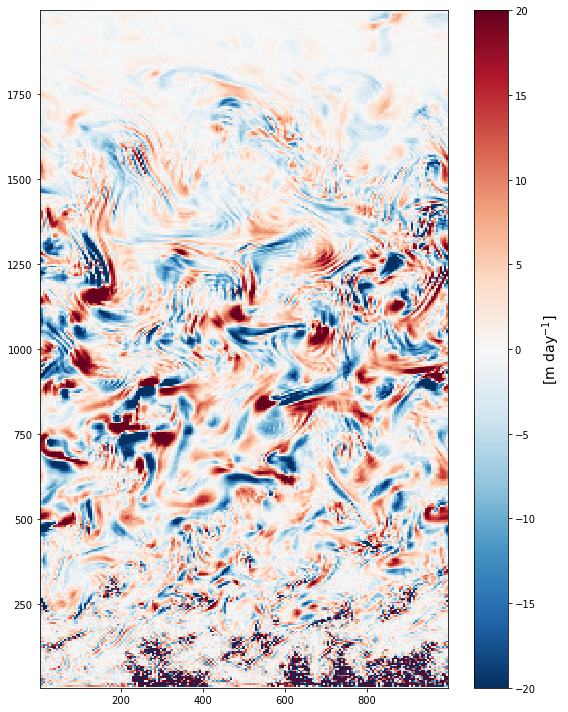

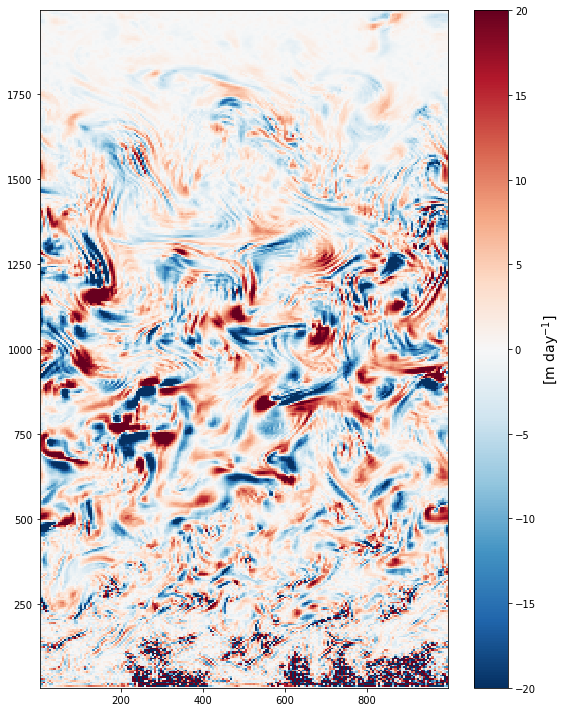

...

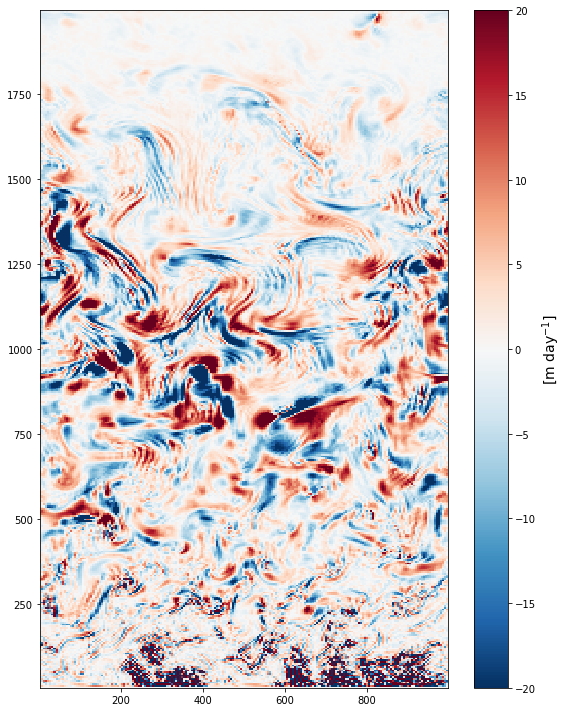

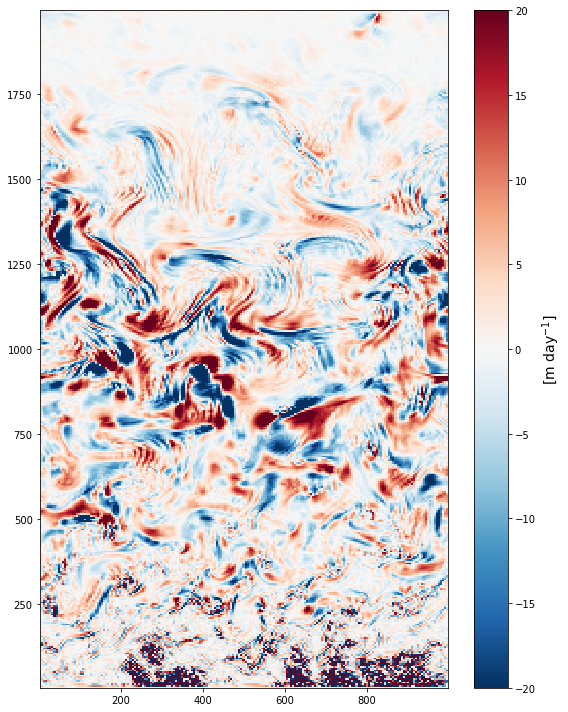

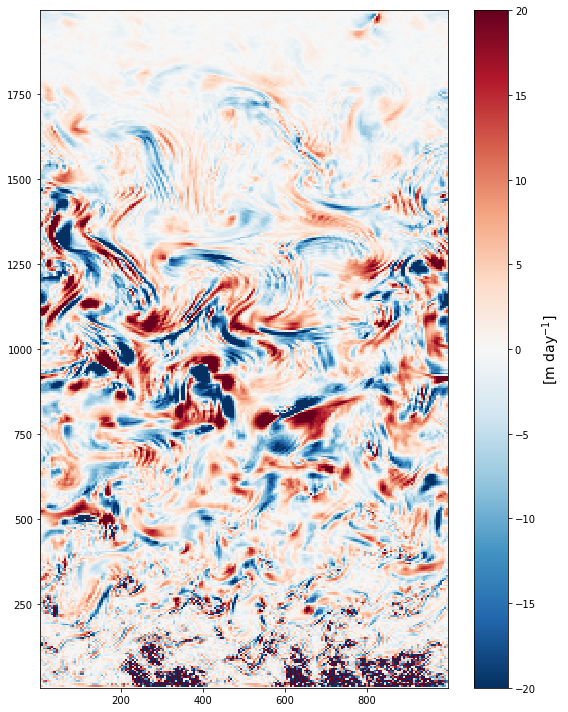

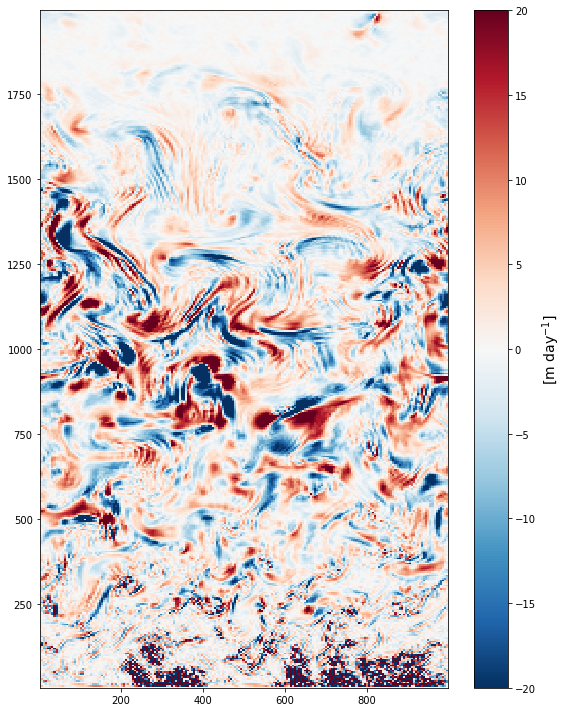

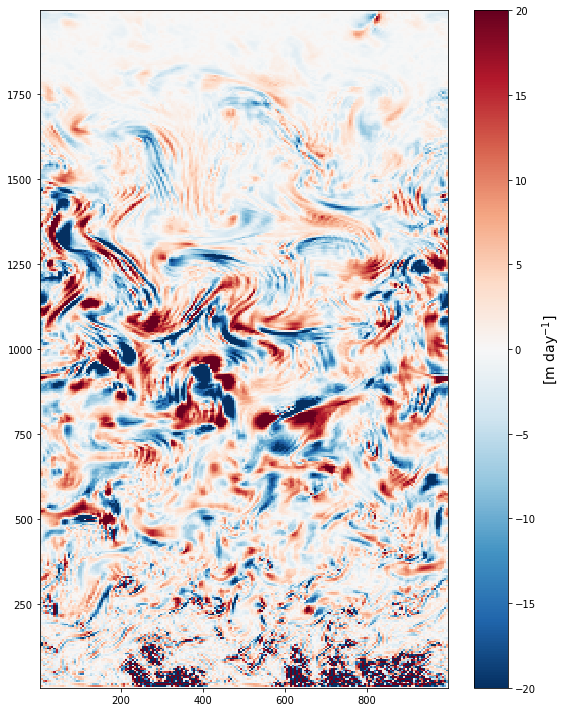

In [ ]:
for i in range(len(ds.time)):
    fig, ax = plt.subplots(figsize=(8,10))
    fig.set_tight_layout(True)
    im = ax.pcolormesh(ds.XC*1e-3, ds.YC*1e-3, ds.WVEL[i,nz300]*86400,
                      vmin=-2e1, vmax=2e1, cmap='RdBu_r', rasterized=True)
    cbar = fig.colorbar(im, ax=ax)
    cbar.set_label(r"[m day$^{-1}$]", fontsize=14)
#     if i == 0:
#         plt.show()
    plt.savefig(op.join(pdir,'Whourly/w_05km_hourlysnap_z300m_%04d.png' % i))

In [9]:
# N = [w.shape[n] for n in [0,-1]]
ps300 = (wkf*np.conj(wkf)).real
cs300 = (wkf*np.conj(Fekf)).real
# cs300 /= (np.asarray(N).prod())**2
# cs300 /= cs300.freq_time_spacing
# cs300 /= freq_XC_spacing
ps300 *= ps300.freq_XC
ps300 *= ps300.freq_time
cs300 *= cs300.freq_XC
cs300 *= cs300.freq_time
cs300

<xarray.DataArray (freq_time: 12960, YC: 160, freq_XC: 200)>
array([[[-1.710474e-19, -2.934375e-20, ..., -4.947259e-20,  2.934375e-20],
        [ 1.533728e-20, -8.396051e-21, ..., -2.118830e-21,  8.396051e-21],
        ...,
        [-2.180597e-19,  6.442106e-19, ...,  1.001393e-19, -6.442106e-19],
        [-3.210537e-19, -1.444480e-20, ...,  2.509359e-19,  1.444480e-20]],

       [[-3.503791e-20, -1.873969e-20, ...,  1.668887e-20,  1.962854e-20],
        [ 7.484539e-20, -5.860385e-20, ..., -1.395919e-19,  1.135387e-20],
        ...,
        [-1.486321e-19,  1.990908e-19, ..., -2.256063e-19, -3.536610e-20],
        [-4.052914e-19,  3.842370e-20, ...,  1.518820e-18, -7.793841e-20]],

       ...,

       [[ 2.803669e-20,  1.008443e-20, ...,  7.770781e-20, -5.058346e-20],
        [-1.207458e-19,  3.218349e-20, ...,  1.465113e-21, -5.616314e-20],
        ...,
        [-1.127010e-19,  1.552814e-20, ...,  1.249507e-19,  7.854580e-20],
        [ 4.362396e-19, -2.064606e-19, ..., -1.539748e-19,

/home/takaya/miniconda3/envs/uptodate/lib/python3.6/site-packages/matplotlib/contour.py:1544: UserWarning: Log scale: values of z <= 0 have been masked
  warnings.warn('Log scale: values of z <= 0 have been masked')
/home/takaya/miniconda3/envs/uptodate/lib/python3.6/site-packages/matplotlib/figure.py:2299: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


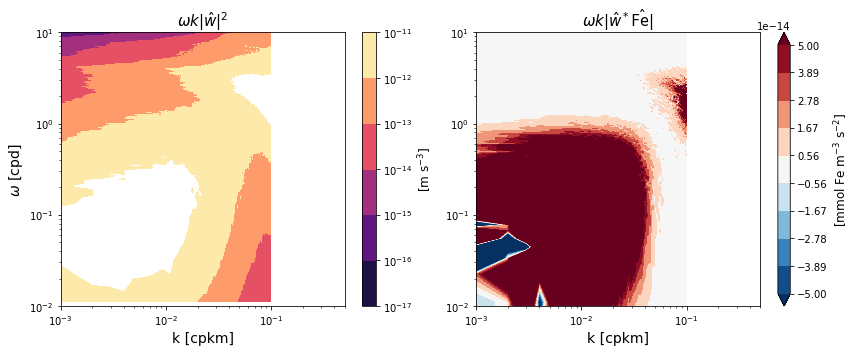

In [10]:
fig, (ax1,ax2) = plt.subplots(figsize=(12,5), nrows=1, ncols=2)
fig.set_tight_layout(True)
im1 = ax1.contourf(ps300.freq_XC[101:]*1e3, ps300.freq_time[4321:]*86400, ps300.mean('YC')[4321:,101:],
                  cmap='magma', norm=LogNorm(), levels=np.logspace(-17,-11,7))
ax1.set_xscale('log')
ax1.set_yscale('log')
ax1.set_ylim([10e1**-1,1e1])
ax1.set_xlim([1e-3,5e-1])
ax1.set_xlabel(r'k [cpkm]', fontsize=14)
ax1.set_ylabel(r'$\omega$ [cpd]', fontsize=14)
im2 = ax2.contourf(cs300.freq_XC[101:]*1e3, cs300.freq_time[4321:]*86400, cs300.mean('YC')[4321:,101:],
                  cmap='RdBu_r', levels=np.linspace(-5e-14,5e-14,10), extend='both')
ax2.set_xscale('log')
ax2.set_yscale('log')
ax2.set_ylim([10e1**-1,1e1])
ax2.set_xlim([1e-3,5e-1])
ax2.set_xlabel(r'k [cpkm]', fontsize=14)
# ax2.set_ylabel(r'$\omega$ [cpd]', fontsize=14)
# tkx1 = ax1.xaxis.get_major_ticks()
# tkx1.label.set_fontsize(12)
# tky1 = ax1.yaxis.get_major_ticks()
# tky1.label.set_fontsize(12)
# tkx2 = ax2.xaxis.get_major_ticks()
# tkx2.label.set_fontsize(12)
# tky2 = ax2.yaxis.get_major_ticks()
# tky2.label.set_fontsize(12)
cbar1 = fig.colorbar(im1, ax=ax1)
cbar1.set_label(r"[m s$^{-3}$]", fontsize=12)
cbar2 = fig.colorbar(im2, ax=ax2)
cbar2.set_label(r"[mmol Fe m$^{-3}$ s$^{-2}$]", fontsize=12)
ax1.set_title(r"$\omega k |\hat{w}|^2$", fontsize=15)
ax2.set_title(r"$\omega k |\hat{w}^*\hat{\tt Fe}|$", fontsize=15)
plt.savefig(op.join(pdir,'Figures/w2-wFe_10mn_k-w-spectra_05km.pdf'))

In [120]:
nt30 = int(30*24)

wASON = w[int(7*nt30):int(11*nt30),nz300]
wpASON = wASON - wASON.mean(['time','XC'])
FeASON = Fe[int(7*nt30):int(11*nt30),nz300]
FepASON = FeASON - FeASON.mean(['time','XC'])
wkfASON = xrft.dft(wpASON, dim=['XC'], detrend='constant')
FekfASON = xrft.dft(FepASON, dim=['XC'], detrend='constant')
freq_XC_spacing = wkfASON.freq_XC_spacing
# wkfON = xrft.dft(w[:nt30,nz100], dim=['XC'], detrend='constant')
# FekfON = xrft.dft(Fe[:nt30,nz100], dim=['XC'], detrend='constant')
with ProgressBar():
    wkfASON = xrft.dft(wkfASON.chunk({'time':int(4*nt30)}), dim=['time'], detrend='constant', window=True).compute()
    FekfASON = xrft.dft(FekfASON.chunk({'time':int(4*nt30)}), dim=['time'], detrend='constant', window=True).compute()

/home/takaya/xrft/xrft/xrft.py:272: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  elif d in da:
/home/takaya/xrft/xrft/xrft.py:272: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  elif d in da:
/home/takaya/xrft/xrft/xrft.py:272: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  elif d in da:


[########################################] | 100% Completed |  2min  7.2s


/home/takaya/xrft/xrft/xrft.py:272: FutureWarning: xarray.DataArray.__contains__ currently checks membership in DataArray.coords, but in xarray v0.11 will change to check membership in array values.
  elif d in da:


[########################################] | 100% Completed |  5min  0.7s


In [121]:
# N = [w.shape[n] for n in [0,-1]]
csASON = (wkfASON*np.conj(FekfASON)).real
# csASO /= (3*nt30*2e2)**2
# csASO /= csASO.freq_time_spacing
# csASO /= freq_XC_spacing
csASON *= csASON.freq_XC
csASON *= csASON.freq_time
csASON

<xarray.DataArray (freq_time: 2880, YC: 160, freq_XC: 200)>
array([[[ 4.583578e-18,  2.154280e-17, ..., -1.259582e-17, -2.154280e-17],
        [ 1.550925e-18,  1.327561e-17, ...,  2.787476e-18, -1.327561e-17],
        ...,
        [-3.889683e-17,  2.307652e-17, ...,  7.782993e-18, -2.307652e-17],
        [ 9.064985e-17, -2.323847e-17, ..., -6.425445e-17,  2.323847e-17]],

       [[-9.433894e-18,  2.391775e-17, ...,  5.746770e-18, -1.515139e-17],
        [-7.417555e-18,  7.848510e-18, ..., -1.068598e-17, -2.600740e-17],
        ...,
        [-1.887102e-17,  1.339393e-17, ...,  1.448152e-16,  1.252685e-17],
        [ 7.032739e-17, -3.305689e-17, ..., -5.091810e-17, -1.674248e-17]],

       ...,

       [[ 1.083941e-18, -8.373161e-18, ..., -1.165411e-17,  1.225836e-17],
        [ 7.313868e-18, -3.296801e-17, ...,  7.779764e-18, -2.574689e-18],
        ...,
        [-1.911685e-18,  3.081974e-17, ...,  6.061917e-18, -3.020988e-17],
        [-1.055302e-17, -3.834627e-17, ...,  3.304433e-17, 

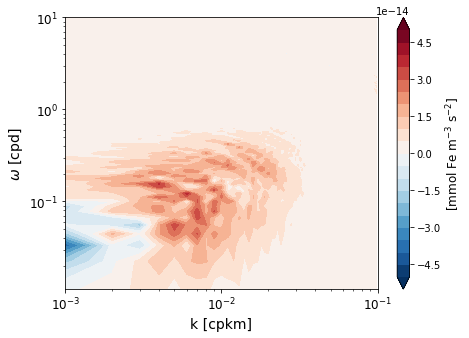

In [122]:
fig, ax = plt.subplots(figsize=(7,5))
im = ax.contourf(csASO.freq_XC[101:]*1e3, csASO.freq_time[int(.5*3*nt30+1):]*86400, 
                csASO.mean('YC')[int(.5*3*nt30+1):,101:],
                cmap='RdBu_r', levels=np.linspace(-5e-14,5e-14,21), extend='both')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_ylim([9e1**-1,1e1])
ax.set_xlim([1e-3,1e-1])
ax.set_xlabel(r'k [cpkm]', fontsize=14)
ax.set_ylabel(r'$\omega$ [cpd]', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
cbar = fig.colorbar(im, ax=ax)
cbar.set_label(r"[mmol Fe m$^{-3}$ s$^{-2}$]", fontsize=12)

In [28]:
wkf400 = xrft.dft(w[:,nz400], dim=['XC'], detrend='constant')
Fekf400 = xrft.dft(Fe[:,nz400], dim=['XC'], detrend='constant')
with ProgressBar():
    wkf400 = xrft.dft(wkf400.chunk({'time':8640}), dim=['time'], detrend='constant', window=True).compute()
    Fekf400 = xrft.dft(Fekf400.chunk({'time':8640}), dim=['time'], detrend='constant', window=True).compute()

KeyboardInterrupt: 

In [33]:
N = [w.shape[n] for n in [0,-1]]
cs400 = (wkf400*np.conj(Fekf400)).real
cs400 /= (np.asarray(N).prod())**2
cs400 /= cs400.freq_time_spacing
cs400 /= freq_XC_spacing
cs400

<xarray.DataArray (freq_time: 8640, YC: 160, freq_XC: 200)>
array([[[ 2.991703e-10,  1.074397e-08, ..., -3.087925e-09,  1.074397e-08],
        [-2.267571e-09, -7.205550e-09, ..., -1.075437e-09, -7.205550e-09],
        ...,
        [ 2.297245e-08, -1.880633e-08, ..., -7.994182e-08, -1.880633e-08],
        [ 9.069972e-09, -4.303166e-08, ..., -2.975784e-09, -4.303166e-08]],

       [[ 9.332684e-09,  3.262376e-09, ..., -2.996317e-09,  1.250967e-09],
        [ 2.396122e-10,  1.056731e-09, ...,  1.158907e-08, -6.389473e-09],
        ...,
        [-9.209984e-09,  2.837321e-08, ..., -2.132009e-08, -2.300502e-08],
        [ 1.916943e-09, -1.470786e-08, ..., -6.076940e-09, -2.587664e-08]],

       ...,

       [[-7.582237e-09,  5.696107e-09, ...,  4.579094e-10,  4.775653e-09],
        [ 2.696987e-09,  1.224543e-09, ...,  3.497157e-09,  5.001129e-09],
        ...,
        [-4.943002e-08,  8.179664e-08, ...,  9.065486e-08, -8.877879e-09],
        [ 4.635878e-08, -2.569890e-08, ..., -1.103082e-08, 

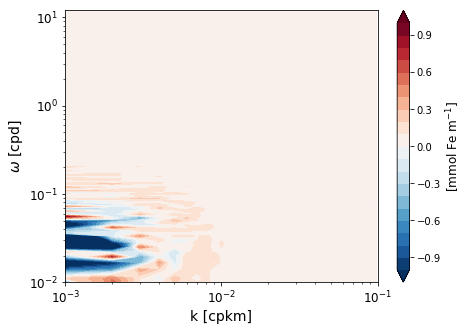

In [43]:
fig, ax = plt.subplots(figsize=(7,5))
im = ax.contourf(cs400.freq_XC[101:]*1e3, cs400.freq_time[4321:]*86400, cs400.mean('YC')[4321:,101:],
                cmap='RdBu_r', levels=np.linspace(-1,1,21), extend='both')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_ylim([10e1**-1,(2*3600)**-1*86400])
ax.set_xlim([1e-3,1e-1])
ax.set_xlabel(r'k [cpkm]', fontsize=14)
ax.set_ylabel(r'$\omega$ [cpd]', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
cbar = fig.colorbar(im, ax=ax)
cbar.set_label(r"[mmol Fe m$^{-1}$]", fontsize=12)

In [87]:
xrft.cross_spectrum?

Signature: xrft.cross_spectrum(da1, da2, spacing_tol=0.001, dim=None, shift=True, detrend=None, density=True, window=False)
Docstring:
Calculates the cross spectra of da1 and da2.

.. math::

 da1' = da1 - \overline{da1}; da2' = da2 - \overline{da2}
 cs = \mathbb{F}(da1') * {\mathbb{F}(da2')}^*

Parameters
----------
da1 : `xarray.DataArray`
    The data to be transformed
da2 : `xarray.DataArray`
    The data to be transformed
spacing_tol: float (default)
    Spacing tolerance. Fourier transform should not be applied to uneven grid but 
    this restriction can be relaxed with this setting. Use caution.
dim : list (optional)
    The dimensions along which to take the transformation. If `None`, all
    dimensions will be transformed.
shift : bool (optional)
    Whether to shift the fft output.
detrend : str (optional)
    If `constant`, the mean across the transform dimensions will be
    subtracted before calculating the Fourier transform (FT).
    If `linear`, the linear least-square 